In [1]:
library(ggplot2)
library(dplyr)
library(RColorBrewer)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [2]:
#######################################################
########### Option 1: plot all cells

In [3]:
## or Monocytes only but on dimensionality reduction building all cells

In [4]:
#### Sara's files
# mydir = "/directflow/SCCGGroupShare/projects/sarba2/data/onek1k/samples/"
mydir = "/share/ScratchGeneral/anncuo/OneK1K/Saras_files/"

In [5]:
in_seurat_file = paste0(mydir,"cell_type.RDS")
in_indiv_phen_file = paste0(mydir,"phen.RDS")
in_meta_file = paste0(mydir,"metadata.Rdata")

In [15]:
# Read in seurat object and individual metadata 
# obj   <- readRDS(in_seurat_file)
phens <- readRDS(in_indiv_phen_file)
load(in_meta_file) 
obj@meta.data = metadata 

In [9]:
obj

Loading required package: Seurat

Attaching SeuratObject



An object of class Seurat 
57641 features across 1272489 samples within 2 assays 
Active assay: SCT (24903 features, 3000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [10]:
umap_df = as.data.frame(Embeddings(obj, reduction = "umap"))
dim(umap_df)
head(umap_df)

[1] 1272489       2

,UMAP_1,UMAP_2
,<dbl>,<dbl>
AAACCTGAGAATGTTG-1,-1.3250431,-4.065017
AAACCTGAGAGAACAG-1,-2.1187532,13.364066
AAACCTGAGCATGGCA-1,5.2636104,-2.043657
AAACCTGAGTATTGGA-1,2.9235904,4.613274
AAACCTGAGTGTCCCG-1,0.9407235,6.925539
AAACCTGCAAATTGCC-1,-2.7601063,-6.454456


In [16]:
head(obj@meta.data,2)

,orig.ident,nCount_RNA,nFeature_RNA,pool,individual,percent.mt,latent,nCount_SCT,nFeature_SCT,cell_type,⋯,age,sex,predicted.celltype,predicted.celltype.l3,predicted.celltype.l4,predicted.celltype.l5,predicted.celltype.l6,G2M.Score,S.Score,Phase
,<fct>,<dbl>,<int>,<fct>,<chr>,<dbl>,<fct>,<dbl>,<int>,<fct>,⋯,<int>,<int>,<fct>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>
AAACCTGAGAATGTTG-1,onek1k,4754,1201,pool_1,691_692,1.451409,b1,3226,1186,CD4+ KLRB1+ T cell,⋯,66,1,CD4+ KLRB1+ T cell,CD4 TEM,CD4 T,T cell,Lymphoid,-0.02439549,0.008654699,S
AAACCTGAGAGAACAG-1,onek1k,2459,896,pool_1,693_694,3.700691,b1,2710,896,XCL1- NK,⋯,88,2,XCL1- NK,NK,NK cell,NK cell,Lymphoid,-0.02651399,-0.015410997,G1


In [17]:
umap_sex = as.data.frame(cbind(umap_df, obj@meta.data))
head(umap_sex,2)

,UMAP_1,UMAP_2,orig.ident,nCount_RNA,nFeature_RNA,pool,individual,percent.mt,latent,nCount_SCT,⋯,age,sex,predicted.celltype,predicted.celltype.l3,predicted.celltype.l4,predicted.celltype.l5,predicted.celltype.l6,G2M.Score,S.Score,Phase
,<dbl>,<dbl>,<fct>,<dbl>,<int>,<fct>,<chr>,<dbl>,<fct>,<dbl>,⋯,<int>,<int>,<fct>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>
AAACCTGAGAATGTTG-1,-1.325043,-4.065017,onek1k,4754,1201,pool_1,691_692,1.451409,b1,3226,⋯,66,1,CD4+ KLRB1+ T cell,CD4 TEM,CD4 T,T cell,Lymphoid,-0.02439549,0.008654699,S
AAACCTGAGAGAACAG-1,-2.118753,13.364066,onek1k,2459,896,pool_1,693_694,3.700691,b1,2710,⋯,88,2,XCL1- NK,NK,NK cell,NK cell,Lymphoid,-0.02651399,-0.015410997,G1


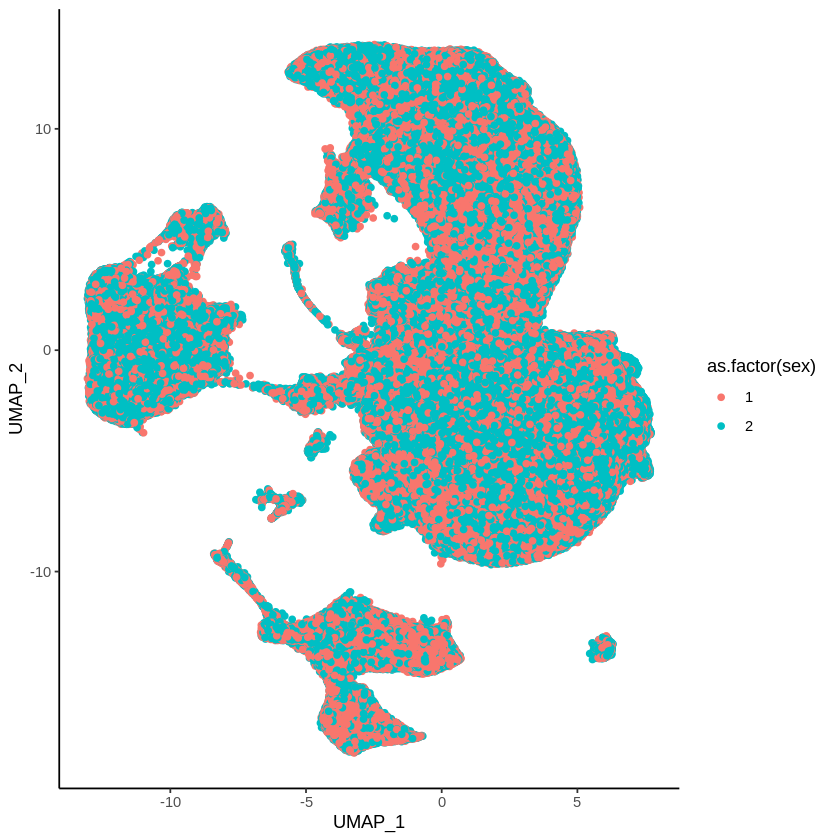

In [18]:
ggplot(umap_sex, aes(x=UMAP_1, y=UMAP_2, colour = as.factor(sex))) + geom_point() + theme_classic()

In [19]:
table(umap_sex$predicted.celltype.l4)


              B cell                CD4 T                CD8 T 
              131878               619968               247295 
                  DC Invariant Lymphocyte             Monocyte 
                6596                17169                54249 
             NK cell 
              183231 

Warning message:
“Removed 12103 rows containing missing values (geom_point).”


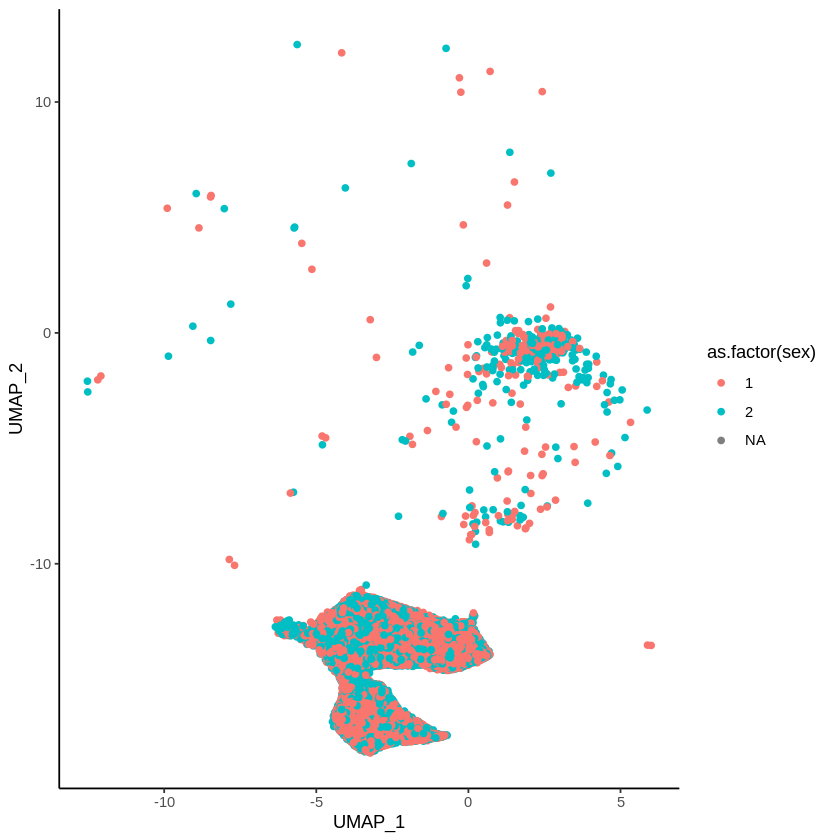

In [20]:
ggplot(umap_sex[umap_sex$predicted.celltype.l4 == 'Monocyte',], 
       aes(x=UMAP_1, y=UMAP_2, colour = as.factor(sex))) + geom_point() + theme_classic()

In [21]:
#######################################################
########### Option 2: recalculate UMAP using
## Monocytes only
## XY genes only

In [22]:
mydir = "/share/ScratchGeneral/anncuo/OneK1K/Saras_files/"
umapXY = load(paste0(mydir,"umap_featuresXY.Rdata")) 

In [23]:
umapXY

[1] "umap_v2"    "featuresXY"

In [24]:
umap_df0 = as.data.frame(umap_v2@cell.embeddings)
head(umap_df0)

,UMAP_1,UMAP_2
,<dbl>,<dbl>
AAACCTGAGAATGTTG-1,-2.9789628,2.19184955
AAACCTGAGAGAACAG-1,2.2736379,1.75215706
AAACCTGAGCATGGCA-1,-3.9830431,2.62789174
AAACCTGAGTATTGGA-1,-1.6844820,2.08543337
AAACCTGAGTGTCCCG-1,0.6066004,-0.09429811
AAACCTGCAAATTGCC-1,3.6632231,-3.21428726


,UMAP_1,UMAP_2,orig.ident,nCount_RNA,nFeature_RNA,pool,individual,percent.mt,latent,nCount_SCT,⋯,age,sex,predicted.celltype,predicted.celltype.l3,predicted.celltype.l4,predicted.celltype.l5,predicted.celltype.l6,G2M.Score,S.Score,Phase
,<dbl>,<dbl>,<fct>,<dbl>,<int>,<fct>,<chr>,<dbl>,<fct>,<dbl>,⋯,<int>,<int>,<fct>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>
AAACCTGAGAATGTTG-1,-2.978963,2.191850,onek1k,4754,1201,pool_1,691_692,1.451409,b1,3226,⋯,66,1,CD4+ KLRB1+ T cell,CD4 TEM,CD4 T,T cell,Lymphoid,-0.02439549,0.008654699,S
AAACCTGAGAGAACAG-1,2.273638,1.752157,onek1k,2459,896,pool_1,693_694,3.700691,b1,2710,⋯,88,2,XCL1- NK,NK,NK cell,NK cell,Lymphoid,-0.02651399,-0.015410997,G1


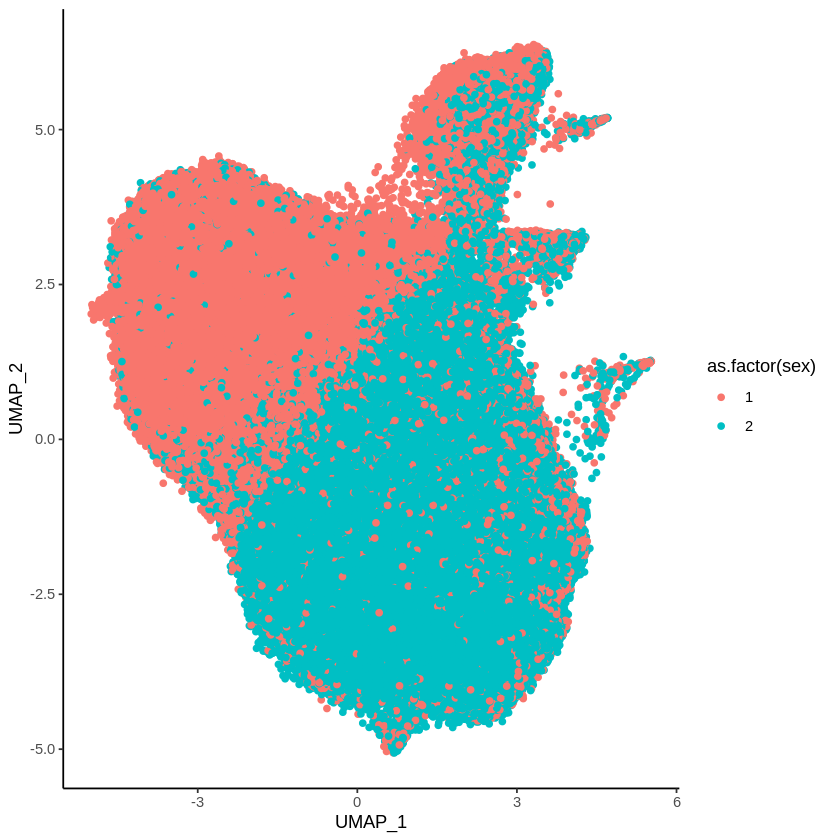

In [25]:
umap_sex = as.data.frame(cbind(umap_df0, obj@meta.data))
head(umap_sex,2)
ggplot(umap_sex, aes(x=UMAP_1, y=UMAP_2, colour = as.factor(sex))) + geom_point() + theme_classic()

Warning message:
“Removed 12103 rows containing missing values (geom_point).”


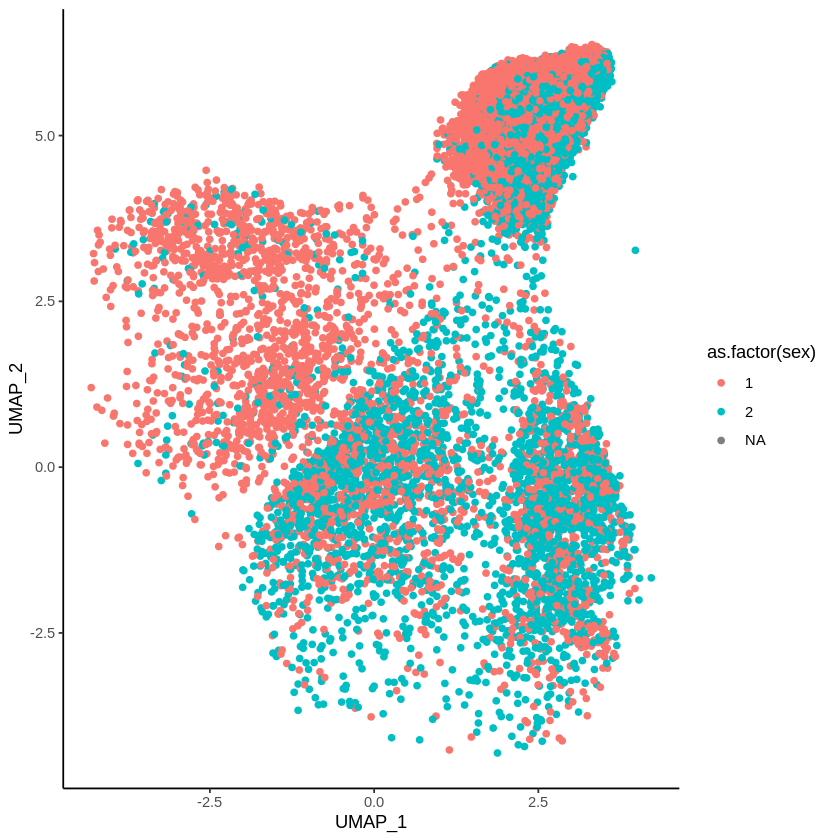

In [26]:
ggplot(umap_sex[umap_sex$predicted.celltype.l4 == 'Monocyte',], 
       aes(x=UMAP_1, y=UMAP_2, colour = as.factor(sex))) + geom_point() + theme_classic()

In [27]:
summary_betaG_file = "/share/ScratchGeneral/anncuo/OneK1K/CRM_interaction/Monocytes_Mono_eQTLs/sex_interactions/betas/summary_betaG.csv"
summary_betaGxC_file = "/share/ScratchGeneral/anncuo/OneK1K/CRM_interaction/Monocytes_Mono_eQTLs/sex_interactions/betas/summary_betaGxC.csv"

In [28]:
df0 = read.csv(summary_betaG_file, row.names=1)
df1 = read.csv(summary_betaGxC_file, row.names=1)
head(df0,2)
head(df1,2)

,betaG
,<dbl>
ANPEP-15:90363995,0.08593688
ASAH1-8:17836501,0.02793629


,ANPEP.15.90363995,ASAH1.8.17836501,C1orf86.1.2060058,C2orf81.2.74878639,C3orf14.3.62327558,CALM2.2.47313757,CD300E.17.72649890,CD36.7.80303762,CD40.20.44747086,CDC42.1.22414785,⋯,RPS8.1.45319121,SEC11A.15.85336311,SERPINB1.6.1939145,SERPINB9.6.2996136,SETD9.5.56213410,SNHG8.4.119925104,TMEM176B.7.150502608,TMSB10.2.85083503,TOMM7.7.22852499,UBA52.19.18699990
,<dbl>,<dbl>,<int>,<dbl>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<int>,<int>,<int>
AAACGGGCACTTAAGC-1,0.001358903,-0.002151632,0,1.616933e-16,0,0,0,0,-0.0001281574,-0.003119871,⋯,-0.007278169,0.0005454698,-0.002873806,0,0,0.003651240,-0.006392169,0,0,0
AAACGGGTCTTGTTTG-1,0.002717806,-0.004303263,0,3.233865e-16,0,0,0,0,-0.0002563148,-0.006239742,⋯,-0.014556338,0.0010909395,-0.005747613,0,0,0.007302481,-0.012784339,0,0,0


In [29]:
df1$barcode = rownames(df1)
head(df1,2)

,ANPEP.15.90363995,ASAH1.8.17836501,C1orf86.1.2060058,C2orf81.2.74878639,C3orf14.3.62327558,CALM2.2.47313757,CD300E.17.72649890,CD36.7.80303762,CD40.20.44747086,CDC42.1.22414785,⋯,SEC11A.15.85336311,SERPINB1.6.1939145,SERPINB9.6.2996136,SETD9.5.56213410,SNHG8.4.119925104,TMEM176B.7.150502608,TMSB10.2.85083503,TOMM7.7.22852499,UBA52.19.18699990,barcode
,<dbl>,<dbl>,<int>,<dbl>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<int>,<int>,<int>,<chr>
AAACGGGCACTTAAGC-1,0.001358903,-0.002151632,0,1.616933e-16,0,0,0,0,-0.0001281574,-0.003119871,⋯,0.0005454698,-0.002873806,0,0,0.003651240,-0.006392169,0,0,0,AAACGGGCACTTAAGC-1
AAACGGGTCTTGTTTG-1,0.002717806,-0.004303263,0,3.233865e-16,0,0,0,0,-0.0002563148,-0.006239742,⋯,0.0010909395,-0.005747613,0,0,0.007302481,-0.012784339,0,0,0,AAACGGGTCTTGTTTG-1


In [30]:
umap_sex$barcode = rownames(umap_sex)
head(umap_sex,2)

,UMAP_1,UMAP_2,orig.ident,nCount_RNA,nFeature_RNA,pool,individual,percent.mt,latent,nCount_SCT,⋯,sex,predicted.celltype,predicted.celltype.l3,predicted.celltype.l4,predicted.celltype.l5,predicted.celltype.l6,G2M.Score,S.Score,Phase,barcode
,<dbl>,<dbl>,<fct>,<dbl>,<int>,<fct>,<chr>,<dbl>,<fct>,<dbl>,⋯,<int>,<fct>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>
AAACCTGAGAATGTTG-1,-2.978963,2.191850,onek1k,4754,1201,pool_1,691_692,1.451409,b1,3226,⋯,1,CD4+ KLRB1+ T cell,CD4 TEM,CD4 T,T cell,Lymphoid,-0.02439549,0.008654699,S,AAACCTGAGAATGTTG-1
AAACCTGAGAGAACAG-1,2.273638,1.752157,onek1k,2459,896,pool_1,693_694,3.700691,b1,2710,⋯,2,XCL1- NK,NK,NK cell,NK cell,Lymphoid,-0.02651399,-0.015410997,G1,AAACCTGAGAGAACAG-1


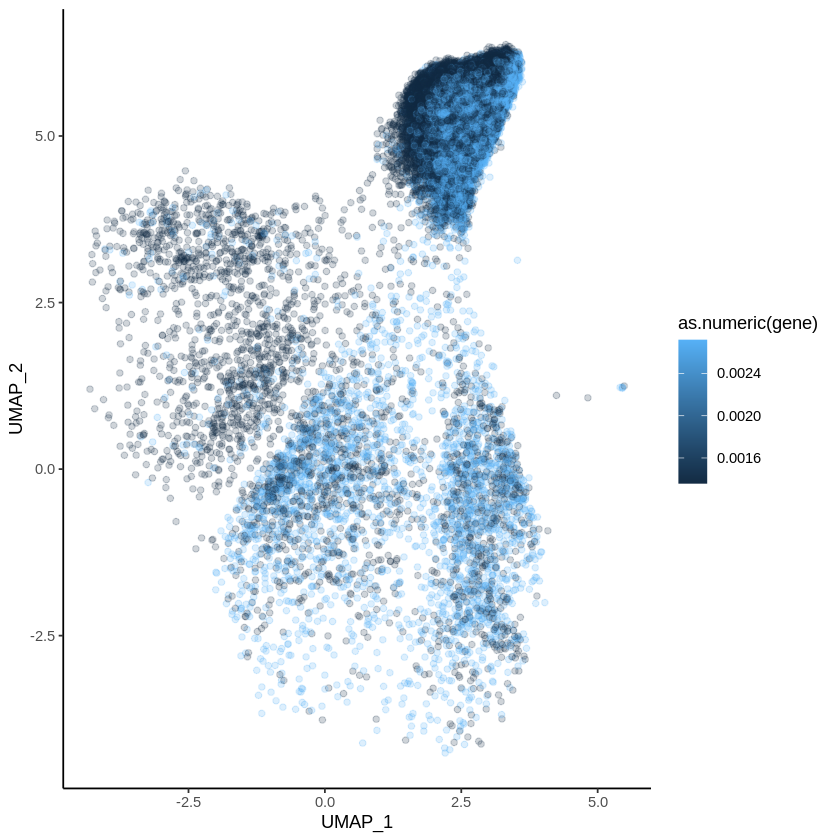

In [31]:
gene = "ANPEP.15.90363995"
df2 = inner_join(umap_sex, as.data.frame(df1[,c("barcode",gene)]), by="barcode")
colnames(df2)[ncol(df2)] = "gene"
p = ggplot(df2, aes(x = UMAP_1, y = UMAP_2, colour = as.numeric(gene))) + geom_point(alpha=0.2) + theme_classic()
# p + scale_colour_gradientn(colors = brewer.pal(9,"Spectral"))
p

In [38]:
gene = "RPL28.19.55897327"
df2 = inner_join(umap_sex, as.data.frame(df1[,c("barcode",gene)]), by="barcode")
colnames(df2)[ncol(df2)] = "gene"
# head(df2)

In [39]:
table(df2$gene, df2$sex)

                     
                          1     2
  -0.0401522569824938     0 28071
  -0.0200761284912469 25328     0

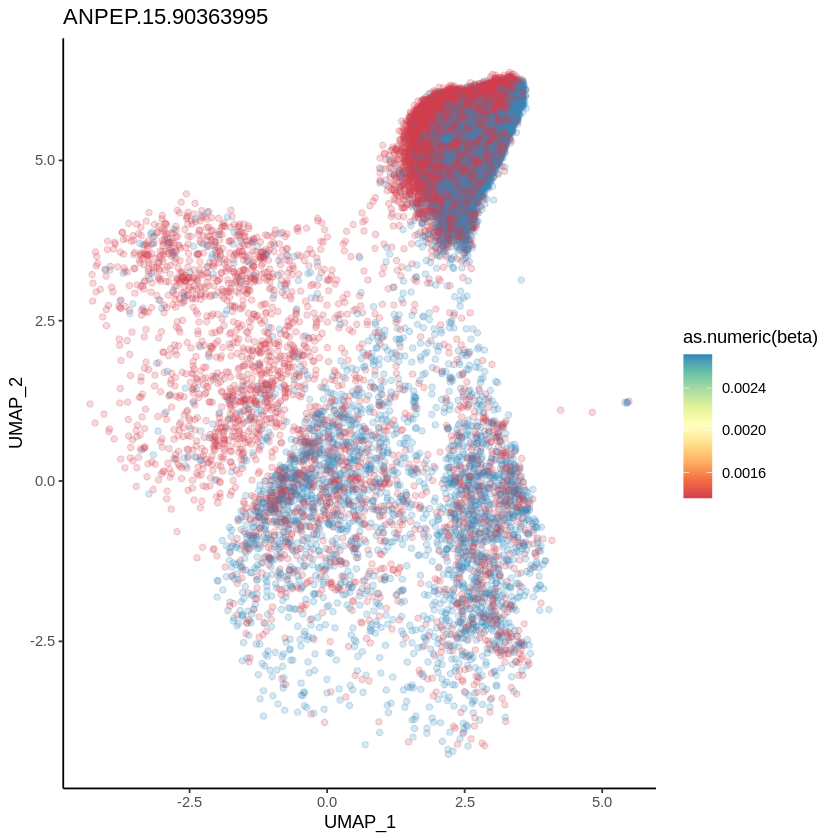

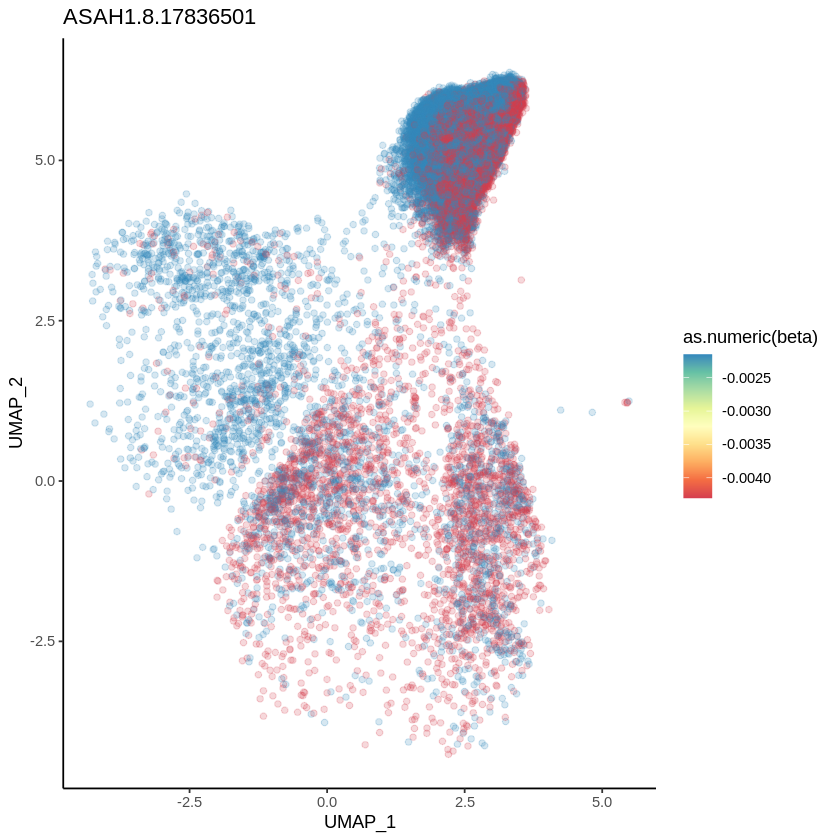

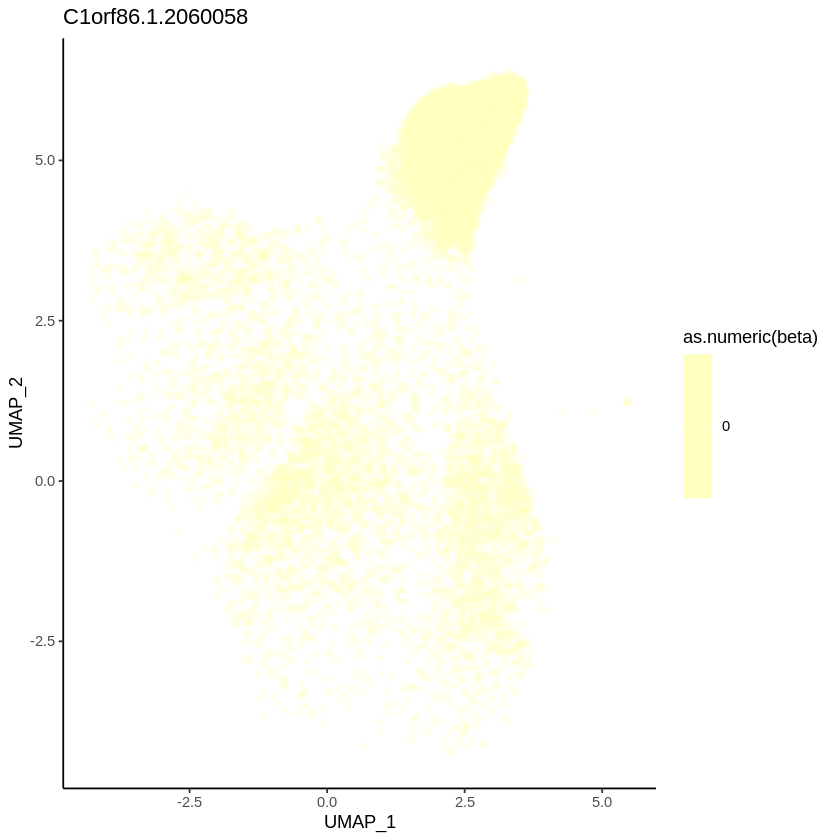

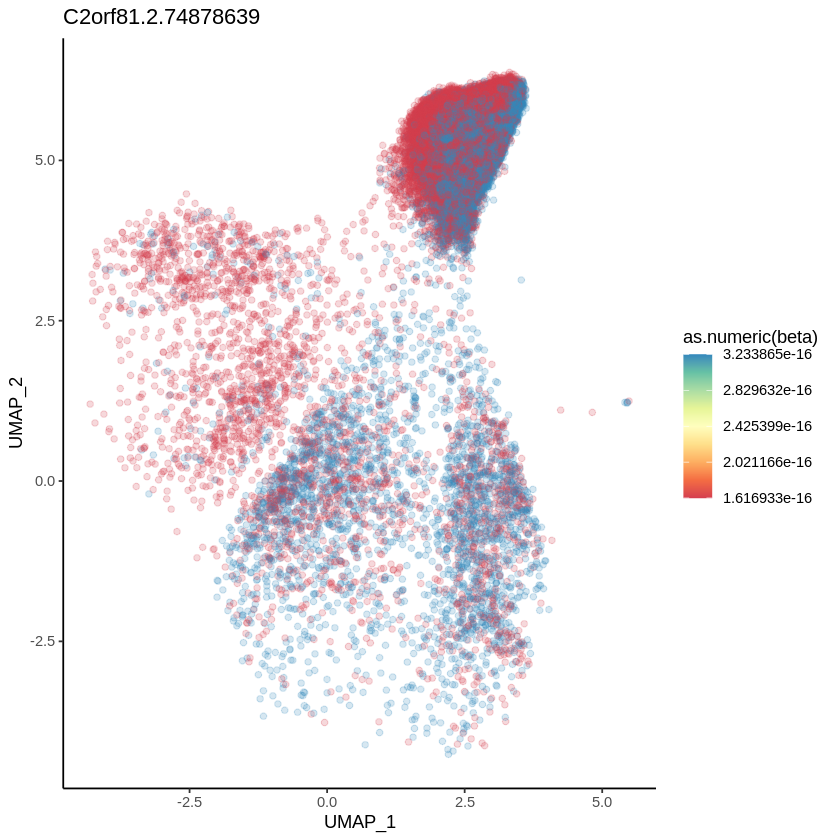

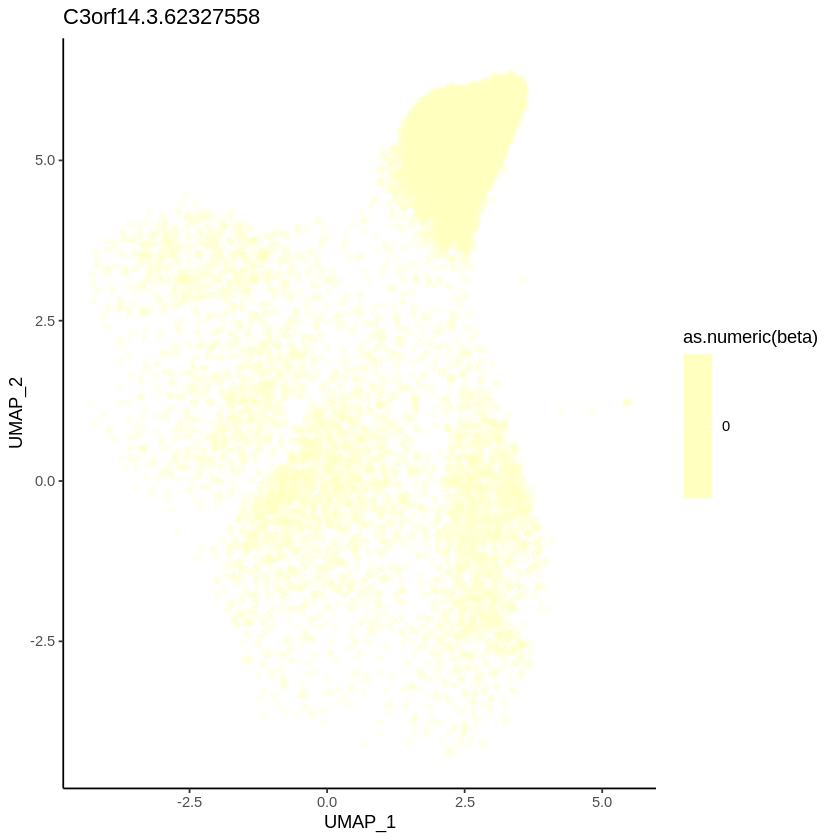

...

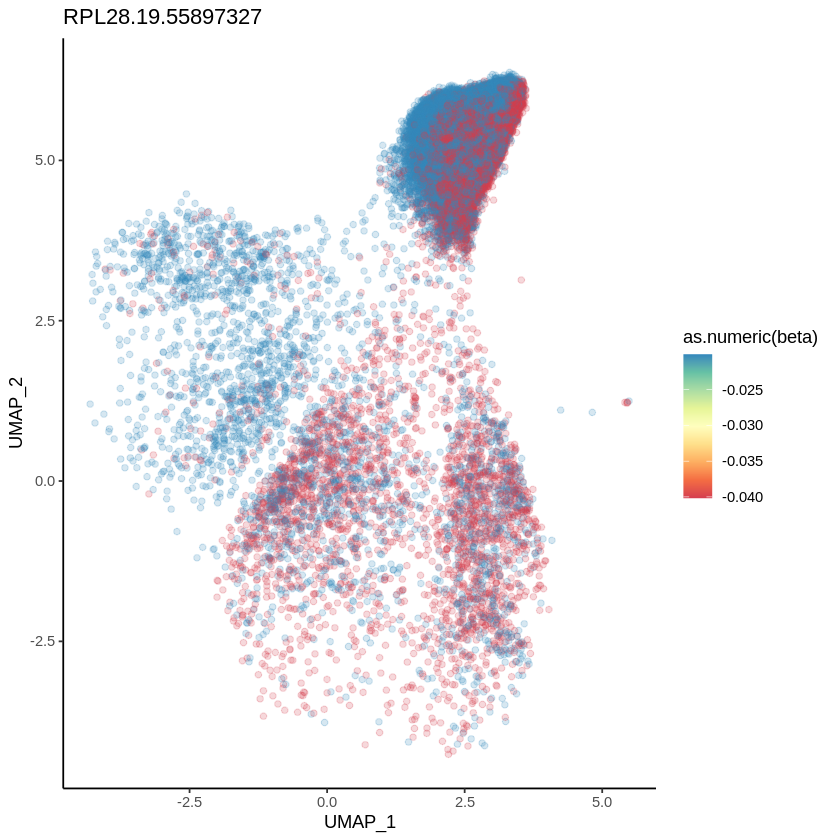

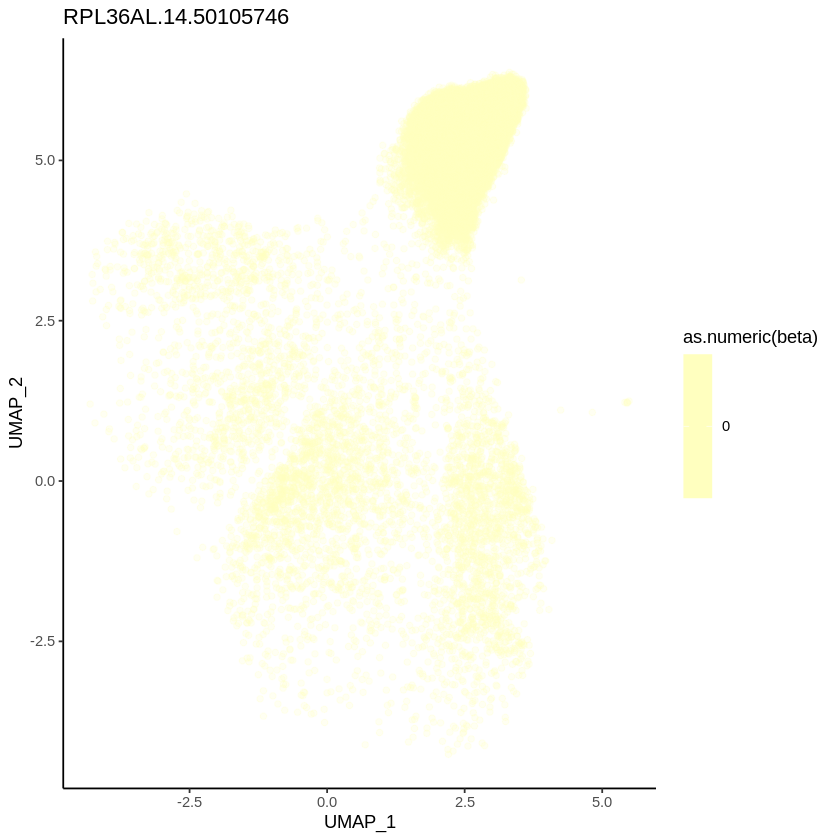

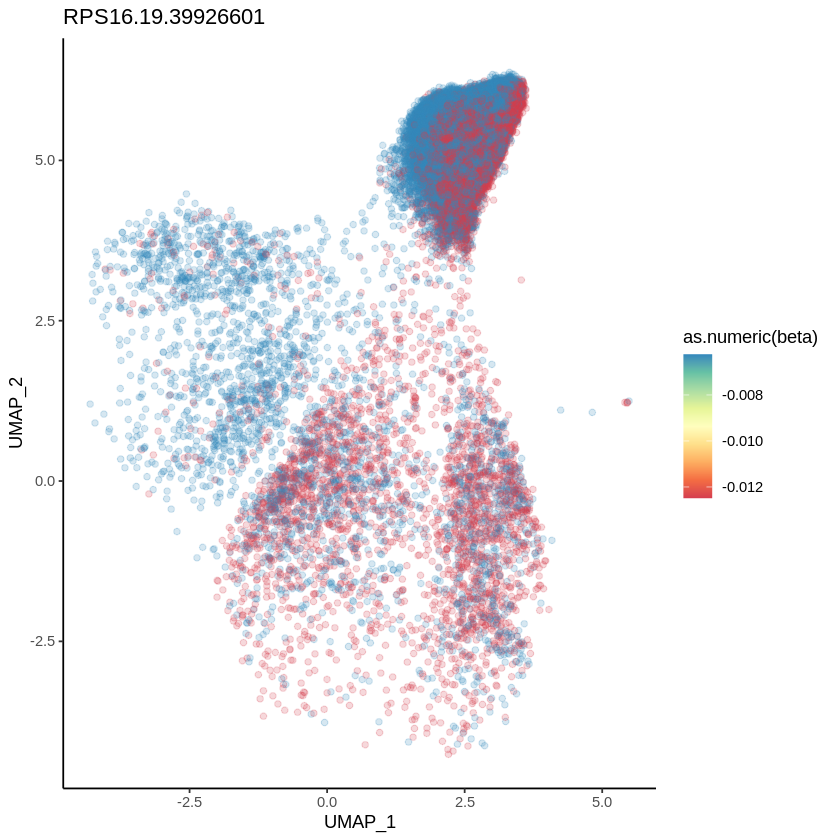

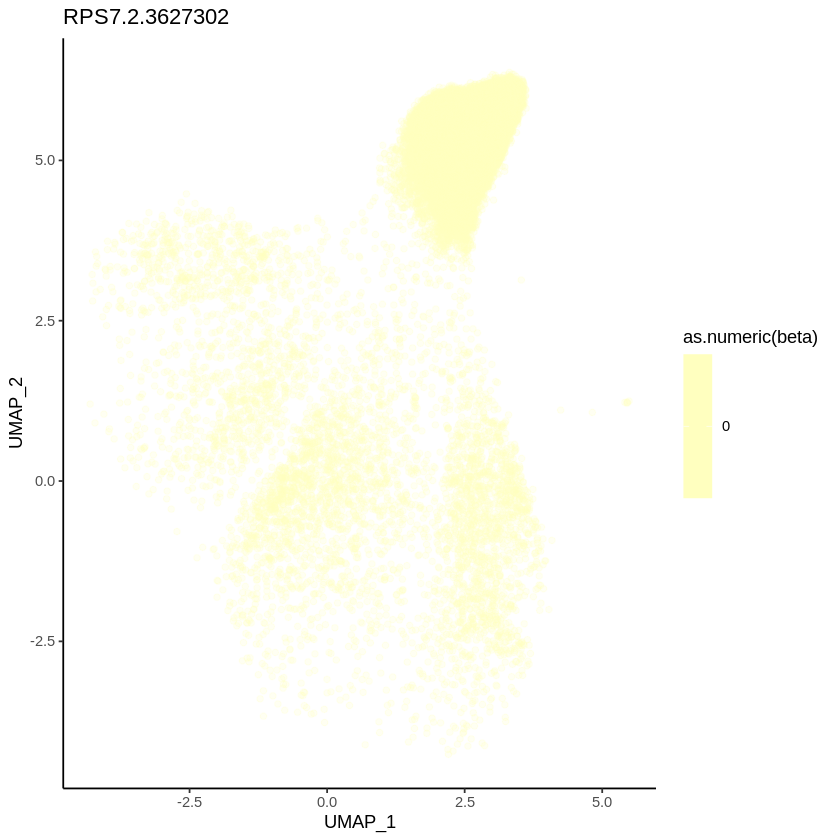

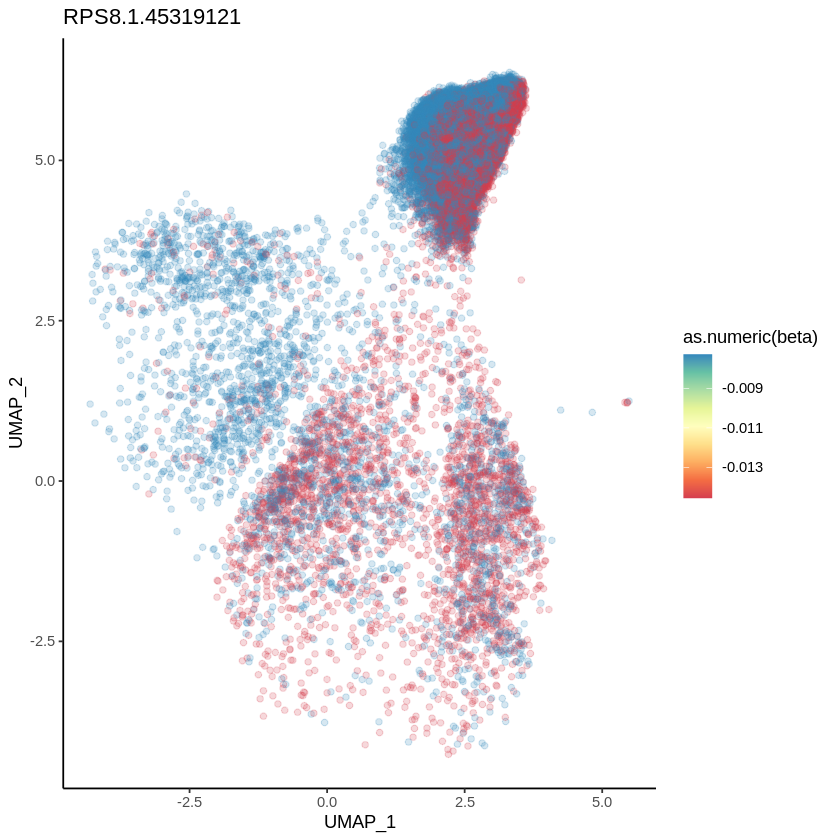

In [32]:
for (gene in colnames(df1)){
    if (gene == "barcode"){next}
    df2 = inner_join(umap_sex, as.data.frame(df1[,c("barcode",gene)]), by="barcode")
    colnames(df2)[ncol(df2)] = "beta"
    p = ggplot(df2, aes(x = UMAP_1, y = UMAP_2, colour = as.numeric(beta))) + geom_point(alpha=0.2) + theme_classic()
    print(p + scale_colour_gradientn(colors = brewer.pal(9,"Spectral")) + ggtitle(gene))
}

In [6]:
genesXY = as.character(featuresXY)
head(genesXY)

[1] "PLCXD1"        "GTPBP6"        "LINC00685"     "PPP2R3B"      
[5] "SHOX"          "RP11-309M23.1"

In [7]:
sce_mono = readRDS("/share/ScratchGeneral/anncuo/OneK1K/Monocytes_sce.rds")

In [8]:
sce_mono

Loading required package: SeuratObject

Loading required package: Seurat



An object of class Seurat 
57641 features across 53399 samples within 2 assays 
Active assay: SCT (24903 features, 3000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [34]:
sce_mono <- RunPCA(sce_mono, features = genesXY)
# sce_mono <- RunUMAP(sce_mono, features = genesXY, umap.method='umap-learn')

Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 673 features requested have not been scaled (running reduction without them): PLCXD1, GTPBP6, PPP2R3B, SHOX, RP11-309M23.1, CRLF2, CSF2RA, SLC25A6, LINC00106, ASMTL-AS1, ASMTL, P2RY8, AKAP17A, ASMT, RP13-297E16.5, DHRSX, ZBED1, LINC00102, XG, GYG2, ARSD, ARSD-AS1, ARSE, ARSF, PRKX, PRKX-AS1, RP11-706O15.1, RP11-706O15.3, RP11-706O15.5, RP11-706O15.7, NLGN4X, RP11-1M18.1, HDHD1, STS, VCX, PNPLA4, RP11-692P14.1, VCX3B, KAL1, FAM9B, GS1-519E5.1, TBL1X, GPR143, WWC3, WWC3-AS1, MID1, RP11-120D5.1, HCCS, MSL3, PRPS2, TLR7, TLR8-AS1, TLR8, RP11-791M20.1, GS1-600G8.5, EGFL6, TCEANC, RAB9A, TRAPPC2, OFD1, GPM6B, RP1-122K4.2, RP1-122K4.3, GEMIN8, GLRA2, FANCB, MOSPD2, ASB9, ASB11, PIGA, PIR, BMX, ACE2, TMEM27, CA5B, ZRSR2, GRPR, CTPS2, SYAP1, TXLNG, RBBP7, REPS2, NHS, SCML1, RAI2, SCML2, CDKL5, RS1, PPEF1, PHKA2-AS1, PHKA2, GPR64, PDHA1, MAP3K15, SH3KBP1, CXorf23, EIF1AX, EIF1AX-AS1, RPS6KA3, CNKSR

In [29]:
umap_df = as.data.frame(Embeddings(sce_mono, reduction = "pca"))
dim(umap_df)
head(umap_df)

[1] 53399    50

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,⋯,PC_41,PC_42,PC_43,PC_44,PC_45,PC_46,PC_47,PC_48,PC_49,PC_50
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACGGGCACTTAAGC-1,15.4357522,-2.460927,1.0244625,-0.90408849,1.03020263,-2.46762244,-0.8759599,-1.1843576,0.040150227,-1.1782247,⋯,0.07733017,-0.10975747,0.09471355,-0.03106164,-0.4285764,-0.12582580,0.02112746,0.1079516575,0.05186953,0.23311555
AAACGGGTCTTGTTTG-1,13.5669891,4.489273,-2.1691957,4.07111750,-1.57173012,5.10791533,-1.3758256,4.0344549,-0.182482583,-8.2913212,⋯,-0.06106545,-0.10281497,0.87279114,-0.07349382,-0.3706698,-0.11566093,0.07801922,0.2261207164,-0.08046828,-0.12216086
AAAGATGAGTACGACG-1,8.7327678,3.298684,2.1215465,0.97887939,0.76534120,-0.58019995,-0.1998752,-1.3199152,-0.028176174,0.3603760,⋯,-0.28392036,0.05874973,-0.01750453,-0.10442119,-0.5280657,-0.16543271,0.04578777,0.1104577229,0.03055870,0.11045778
AAAGATGGTGTGAATA-1,0.6200959,1.468193,0.3828542,-0.08758329,0.17821839,0.61406330,0.5539177,185.0617283,1.609084096,84.1941325,⋯,-0.34844130,0.05054952,1.04830264,-0.11738492,-0.0503735,-0.06860733,-0.11317440,0.0029653508,0.05753661,-0.04843504
AAAGATGTCAAACAAG-1,10.9949851,3.513657,-8.3658509,-0.03479610,-0.02927001,-0.07208114,-0.4124136,-1.2179830,-0.054729185,0.3146723,⋯,0.16202855,-0.06538926,-0.47736186,0.10096241,-0.3755989,-0.08609419,0.08416832,-0.0005526533,-0.06024132,-0.18266007
AAAGCAACACCGCTAG-1,8.1524870,-3.408818,0.7404435,0.34428383,0.91340713,-2.56525220,-0.1482174,-0.9830828,0.009908233,-0.6328003,⋯,0.30028258,-0.05159101,-0.36863091,-0.02970067,0.5001665,0.19977837,0.05113274,0.2587192302,-0.01175807,0.18285676


In [30]:
head(metadata,2)

,orig.ident,nCount_RNA,nFeature_RNA,pool,individual,percent.mt,latent,nCount_SCT,nFeature_SCT,cell_type,⋯,sex,predicted.celltype,predicted.celltype.l3,predicted.celltype.l4,predicted.celltype.l5,predicted.celltype.l6,G2M.Score,S.Score,Phase,cell
,<fct>,<dbl>,<int>,<fct>,<chr>,<dbl>,<fct>,<dbl>,<int>,<fct>,⋯,<int>,<fct>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>
AAACCTGAGAATGTTG-1,onek1k,4754,1201,pool_1,691_692,1.451409,b1,3226,1186,CD4+ KLRB1+ T cell,⋯,1,CD4+ KLRB1+ T cell,CD4 TEM,CD4 T,T cell,Lymphoid,-0.02439549,0.008654699,S,AAACCTGAGAATGTTG-1
AAACCTGAGAGAACAG-1,onek1k,2459,896,pool_1,693_694,3.700691,b1,2710,896,XCL1- NK,⋯,2,XCL1- NK,NK,NK cell,NK cell,Lymphoid,-0.02651399,-0.015410997,G1,AAACCTGAGAGAACAG-1


In [31]:
umap_df$cell = rownames(umap_df)
metadata$cell = rownames(metadata)

In [32]:
df_to_plot = inner_join(umap_df, metadata)
head(df_to_plot,2)

Joining, by = "cell"


,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,⋯,age,sex,predicted.celltype,predicted.celltype.l3,predicted.celltype.l4,predicted.celltype.l5,predicted.celltype.l6,G2M.Score,S.Score,Phase
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<int>,<int>,<fct>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>
1,15.43575,-2.460927,1.024462,-0.9040885,1.030203,-2.467622,-0.8759599,-1.184358,0.04015023,-1.178225,⋯,78,1,Monocyte FCGR3A+,CD16 Mono,Monocyte,Monocyte,Myeloid,0.01696488,-0.02523439,G2M
2,13.56699,4.489273,-2.169196,4.0711175,-1.571730,5.107915,-1.3758256,4.034455,-0.18248258,-8.291321,⋯,88,2,Monocyte CD14+,CD14 Mono,Monocyte,Monocyte,Myeloid,-0.04056924,-0.04031190,G1


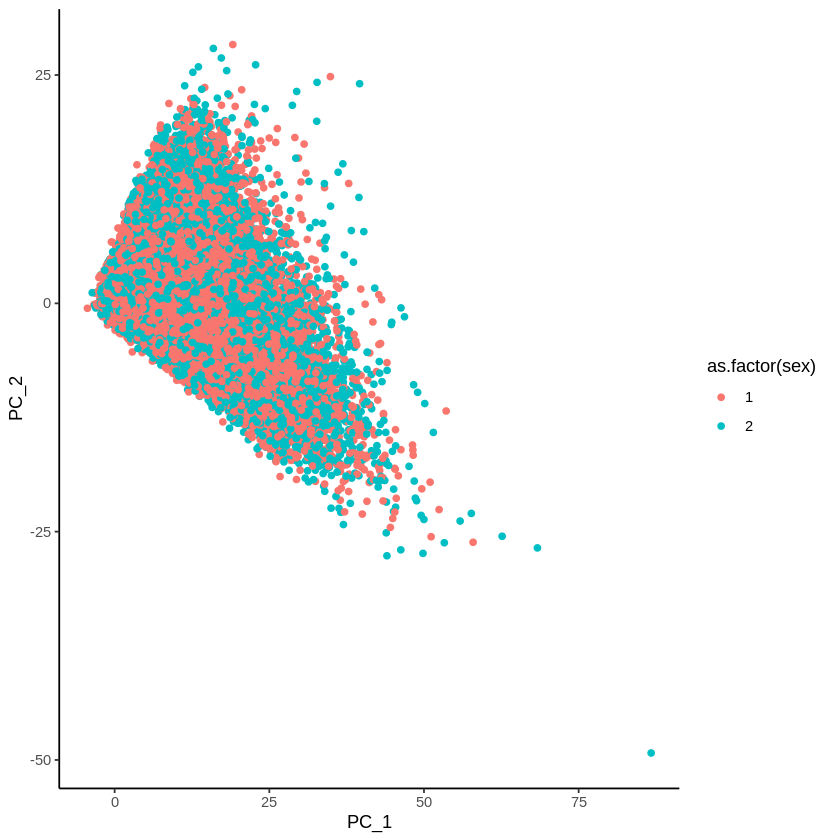

In [33]:
ggplot(df_to_plot, aes(x=PC_1, y=PC_2, colour = as.factor(sex))) + geom_point() + theme_classic()
# ggplot(df_to_plot, aes(x=UMAP_1, y=UMAP_2, colour = as.factor(sex))) + geom_point() + theme_classic()

In [24]:
library(Rtsne)
pcs = as.data.frame(Embeddings(sce_mono, reduction = "pca"))
tsne = Rtsne(pcs)

In [25]:
head(tsne$Y)

-3.969445,-9.469102
-18.660558,-10.014852
-1.197735,8.177450
-14.379905,-8.971489
-19.468950,5.485504
3.757330,3.305609


In [26]:
df_tsne = as.data.frame(tsne$Y)
colnames(df_tsne) = c("tSNE1","tSNE2")
rownames(df_tsne) = colnames(sce_mono)
head(df_tsne)

,tSNE1,tSNE2
,<dbl>,<dbl>
AAACGGGCACTTAAGC-1,-3.969445,-9.469102
AAACGGGTCTTGTTTG-1,-18.660558,-10.014852
AAAGATGAGTACGACG-1,-1.197735,8.177450
AAAGATGGTGTGAATA-1,-14.379905,-8.971489
AAAGATGTCAAACAAG-1,-19.468950,5.485504
AAAGCAACACCGCTAG-1,3.757330,3.305609


In [27]:
df_tsne$cell = rownames(df_tsne)
df_to_plot = inner_join(df_tsne, metadata)
head(df_to_plot,2)

Joining, by = "cell"


,tSNE1,tSNE2,cell,orig.ident,nCount_RNA,nFeature_RNA,pool,individual,percent.mt,latent,⋯,age,sex,predicted.celltype,predicted.celltype.l3,predicted.celltype.l4,predicted.celltype.l5,predicted.celltype.l6,G2M.Score,S.Score,Phase
,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<fct>,<chr>,<dbl>,<fct>,⋯,<int>,<int>,<fct>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>
1,-3.969445,-9.469102,AAACGGGCACTTAAGC-1,onek1k,7546,1849,pool_1,683_684,4.624967,b1,⋯,78,1,Monocyte FCGR3A+,CD16 Mono,Monocyte,Monocyte,Myeloid,0.01696488,-0.02523439,G2M
2,-18.660558,-10.014852,AAACGGGTCTTGTTTG-1,onek1k,7910,2008,pool_1,693_694,3.388116,b1,⋯,88,2,Monocyte CD14+,CD14 Mono,Monocyte,Monocyte,Myeloid,-0.04056924,-0.04031190,G1


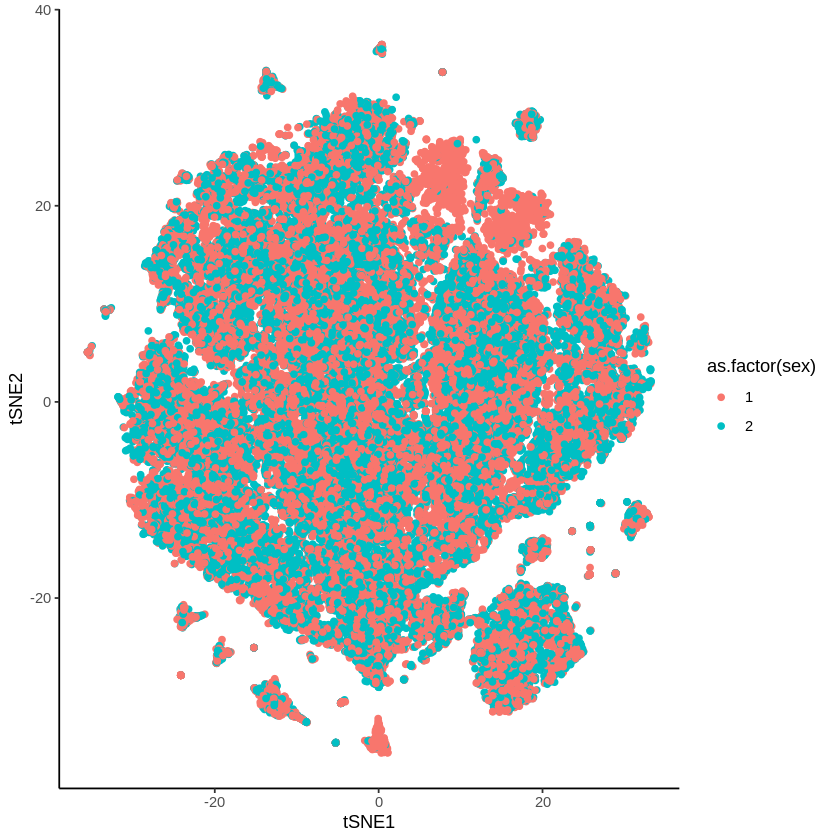

In [28]:
ggplot(df_to_plot, aes(x=tSNE1, y=tSNE2, colour = as.factor(sex))) + geom_point() + theme_classic()

In [9]:
# mydir = "/directflow/SCCGGroupShare/projects/sarba2/projects/onek1k/exprs/"
# load(paste0(mydir,"umap.Rdata"))

In [16]:
# mydir = "/directflow/SCCGGroupShare/projects/sarba2/projects/onek1k/" 
load(paste0(mydir,"umap_featuresXY.Rdata")) 

In [19]:
head(umap_v2)

ERROR: Error in `[.DimReduc`(x, 1:6, , drop = FALSE): None of the requested loadings are present.


In [33]:
obj@reductions$umap@cell.embeddings = umap_v2 # this is in the umap_featuresXY file 

ERROR: Error in (function (cl, name, valueClass) : assignment of an object of class “DimReduc” is not valid for @‘cell.embeddings’ in an object of class “DimReduc”; is(value, "matrix") is not TRUE


In [ ]:
library(EGAD)
featuresXY = attr.human$name[m][ which(attr.human$chr[m] == "chrX"  |  attr.human$chr[m] == "chrY" ) ]  # Pick xy genes
data <- RunPCA(data, features =   as.character(featuresXY ))
data <- RunUMAP(data, features =   as.character(featuresXY ) , umap.method='umap-learn')